# scVelo-RNA velocity analysis of keratinocytes (CellRank)

## Part 1.  RNA velocity analysis per condition separately

In [14]:
import scvelo as scv
import scanpy as sc
import cellrank as cr
import numpy as np
import os
import pandas as pd
import anndata as ad
scv.logging.print_version()
sc.logging.print_header()

Running scvelo 0.2.4 (python 3.8.12) on 2022-02-11 11:24.


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.8.0 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI's XMLRPC API is currently disabled due to unmanageable load and will be deprecated in the near future. See https://status.python.org/ for more information.


In [15]:
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
cr.settings.presenter_view = True
scv.settings.set_figure_params('scvelo', facecolor='white', dpi=300, frameon=False) # for beautified visualization
cr.settings.verbosity = 2

import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

## Part 2. RNA velocity analysis per condition (From combined anndata)

### 1. All combined skin and wounds

# Skin or Combined conditions

In [16]:
# load the combined data (SC and loom files)
adata = sc.read_h5ad('allNew_zs4_RNAvelocity_allCondis.h5ad')

# only keep the skin and filter out unneeded clusters
#adata = adata[adata.obs['Condition'].isin(["Wound30"])]

#cur_celltypes = ['cl13'] 
#adata = adata[~adata.obs['seurat_clusters'].isin(cur_celltypes)]

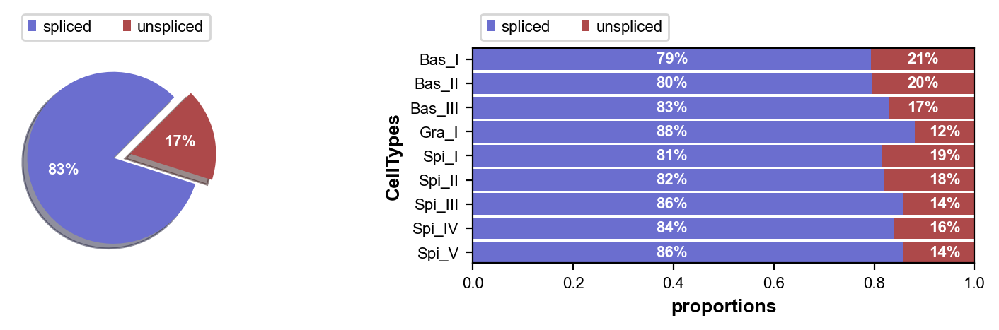

In [17]:
sc.pp.filter_cells(adata, min_genes=1)
# the proportion of spliced and unspliced transcripts in each of our cell clusters. 
scv.pl.proportions(adata, groupby='CellTypes')

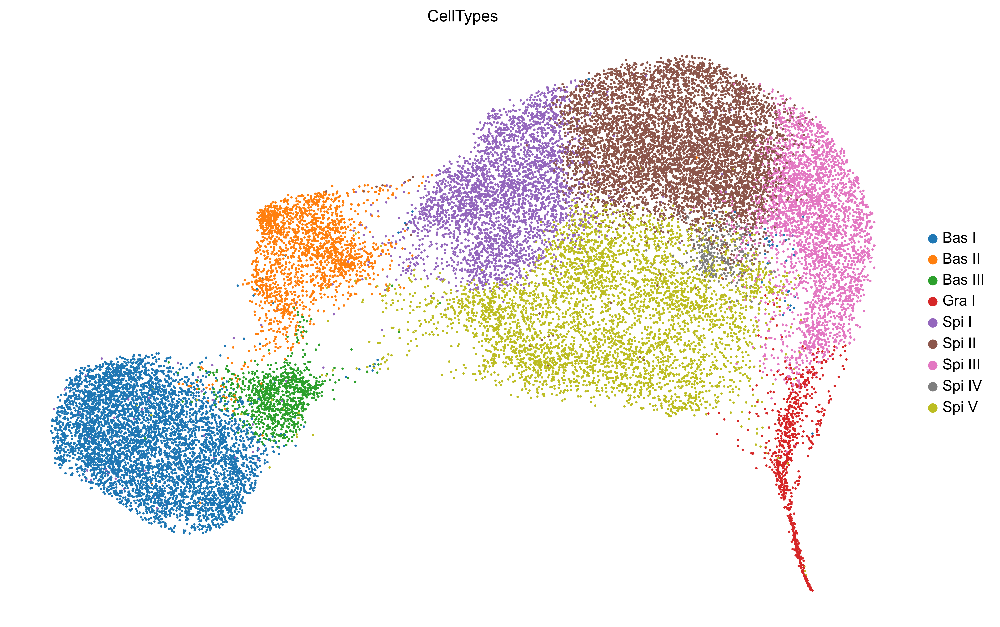

In [7]:
scv.pl.scatter(adata, basis="umap", c="CellTypes", legend_loc="right")

In [18]:
# pre-process
scv.pp.filter_and_normalize(adata, min_shared_counts=20, min_shared_cells=30, log=True, enforce=True, n_top_genes=2000)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=20, use_rep = "X_harmony")
scv.pp.moments(adata, n_pcs=20, n_neighbors=30)

# compute velocity
scv.tl.recover_dynamics(adata, n_jobs=6) #If using dynamical model
scv.tl.velocity(adata, mode='dynamical') #, deterministic, stochastic, dynamical
scv.tl.velocity_graph(adata)

Filtered out 14511 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 6/12 cores)
    finished (0:17:01) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:34) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)
    finished (0:02:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:07) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


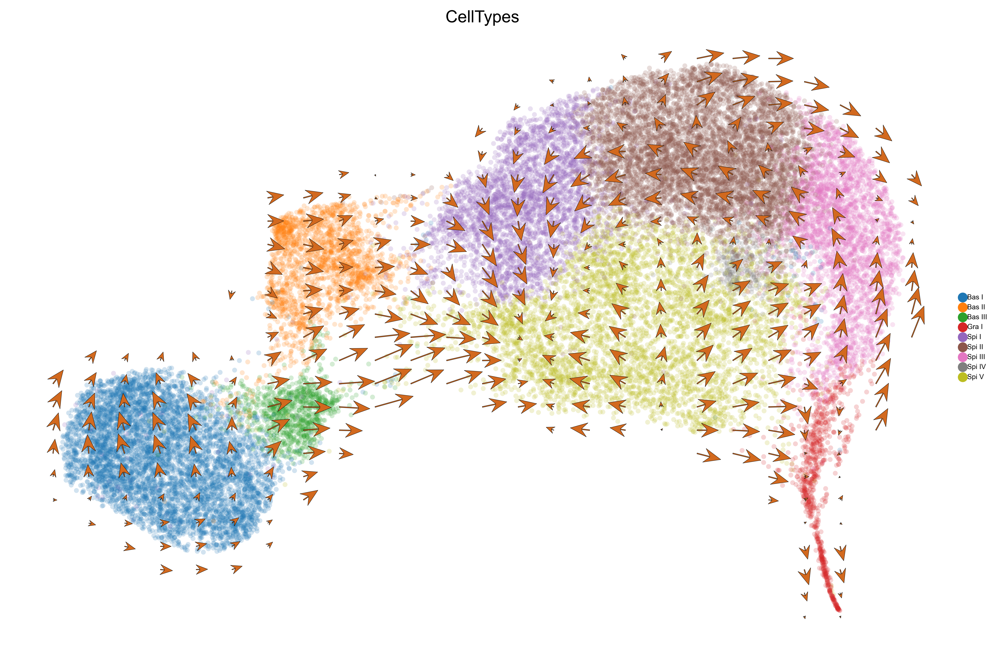

In [19]:
scv.settings.set_figure_params('scvelo', dpi=300)
scv.pl.velocity_embedding_grid(adata, basis='umap',color='CellTypes',arrow_size=3, arrow_length=3,
                               density=0.5, arrow_color="#D2691E", 
                               legend_loc='right margin',legend_fontsize=5)

In [20]:
# Before we can start applying the CytoTRACE kernel, we’ll have to do some basic pre-processing of the data
# filter, normalize total counts and log-transform
#sc.pp.filter_genes(adata, min_cells=10)
#scv.pp.normalize_per_cell(adata)
#sc.pp.log1p(adata)

# hvg annotation
#sc.pp.highly_variable_genes(adata, n_top_genes=2000)
#print(f"This detected {np.sum(adata.var['highly_variable'])} highly variable genes. ")

# use scVelo's `moments` function for imputation - note that hack we're using here:
# we're copying our `.X` matrix into the layers because that's where `scv.tl.moments`
# expects to find counts for imputation
adata.layers["spliced"] = adata.X
adata.layers["unspliced"] = adata.X
scv.pp.moments(adata, n_pcs=20, n_neighbors=30)

computing moments based on connectivities
    finished (0:00:06) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [21]:
# Import the kernel and initialize it using the pre-processed AnnData object
from cellrank.tl.kernels import PseudotimeKernel
pk=PseudotimeKernel(adata, time_key='monocle3_pseudotime')
print(pk)

<PseudotimeKernel>


In [22]:
pk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)

Computing transition matrix based on `monocle3_pseudotime`


100%|█████████████████████████████████████████████████████████████████████████| 27105/27105 [00:05<00:00, 4918.42cell/s]


    Finish (0:00:15)


<PseudotimeKernel>

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:07)


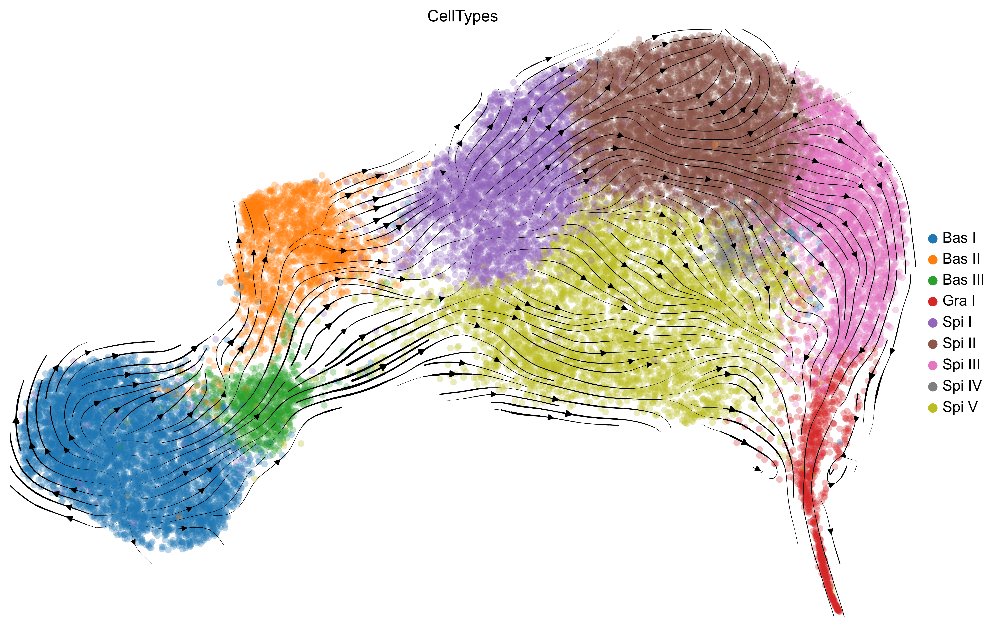

In [23]:
pk.compute_projection(basis="umap")
scv.pl.velocity_embedding_stream(
    adata, color="CellTypes", vkey="T_fwd", basis="umap", legend_loc="right", 
    density = 3, min_mass = 2, dpi=300, title=None
)

In [14]:
# To compute macrostates, and fate probabilities towards a subset of them, we’ll use an estimator object
from cellrank.tl.estimators import GPCCA

g_fwd = GPCCA(pk)
print(g_fwd)

GPCCA[n=27105, kernel=<PseudotimeKernel[dnorm=False, scheme=soft, b=10.0, nu=0.5]>]


Computing Schur decomposition
Mat Object: 1 MPI processes
  type: seqdense
9.9999999999999323e-01 8.2567974204344379e-04 -1.0284477060996757e-03 3.1926410663701901e-03 5.9341980349274046e-03 -3.2332178216764325e-02 1.6262195926231558e-03 -9.1976268930410929e-03 1.9853181903480194e-02 -4.7252066579392973e-02 -4.9611325041519017e-03 1.2650506021148006e-02 -6.3709082859197122e-03 -2.0451706582709783e-02 -2.3527250767466205e-02 -1.6067877752092872e-02 -2.5844631286434463e-02 -8.6326831783684974e-03 7.6360407611703552e-03 -4.1318980064794335e-04 9.8891209334478931e-03 
0.0000000000000000e+00 9.9944666362418966e-01 5.9239119170856921e-04 -1.5145867383902912e-03 -3.8151360475140316e-03 -2.6330107506522971e-03 3.4144296731490509e-03 1.0805588079205373e-02 5.4013906132276482e-03 2.8217596709585692e-03 3.6695980592104508e-03 1.0381491220937232e-02 9.5132552688975431e-03 2.0440019163445136e-02 2.2667855121484667e-02 9.1324527735748354e-03 1.1975246821767923e-02 7.3682148110727347e-03 -4.382797525

Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:22)


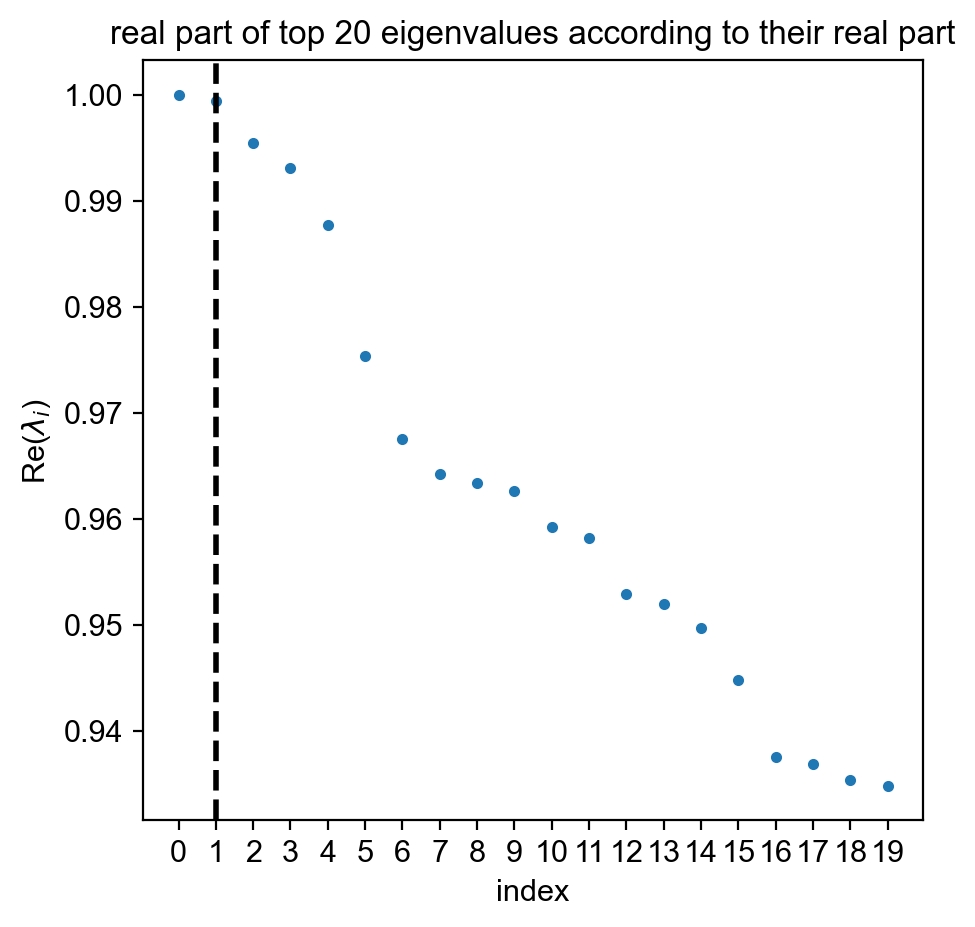

In [15]:
# As always, we’ll compute a Schur decomposition and use that to define our macrostates
g_fwd.compute_schur(n_components=20)
g_fwd.plot_spectrum(real_only=True)

In [16]:
g_fwd.compute_macrostates(n_states=2, cluster_key="CellTypes")

Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)


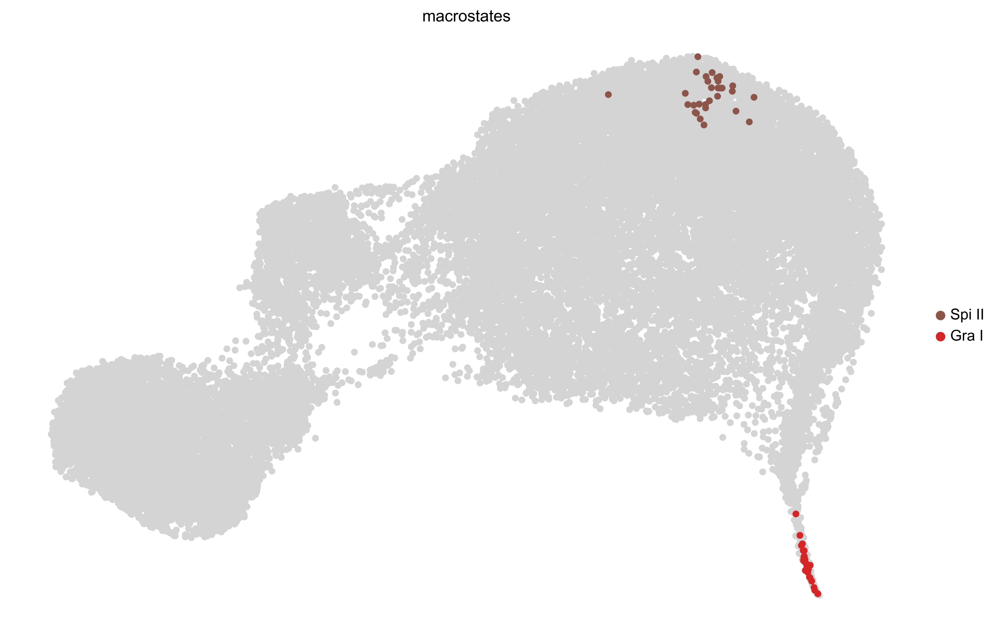

In [17]:
g_fwd.plot_macrostates(
    discrete=True, legend_loc="right", size=100, basis="umap"
)

In [18]:
g_fwd.set_terminal_states_from_macrostates(names=["Gra_I", "Spi_II"])

Adding `adata.obs['terminal_states']`
       `adata.obs['terminal_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


In [19]:
adata.obs[["terminal_states"]].value_counts()

terminal_states
Gra_I              30
Spi_II             30
dtype: int64

Computing absorption probabilities


100%|███████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  2.77/s]

Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:00)


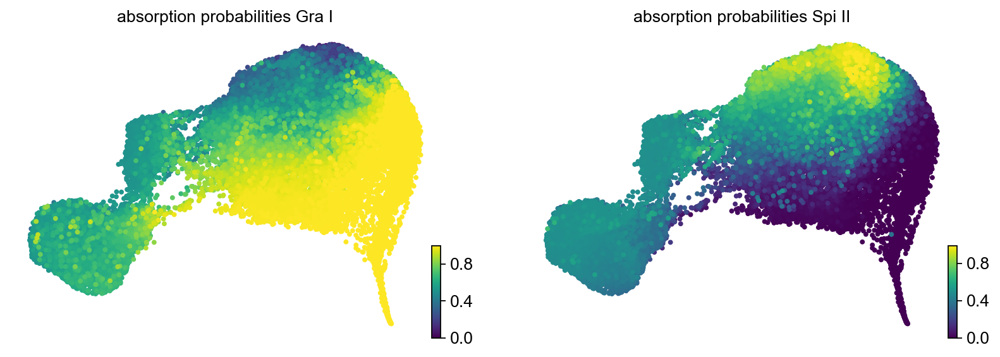

In [20]:
g_fwd.compute_absorption_probabilities()
g_fwd.plot_absorption_probabilities(same_plot=False, size=50, basis="umap")